In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
%config InlineBackend.figure_format='retina'

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

import numpy as np
import pandas as pd

import ROOT, uproot

from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn import feature_selection
from sklearn.model_selection import StratifiedKFold
from sklearn.utils import class_weight
from sklearn import decomposition

# import necessary keras modules/functions
import keras
from keras.models import load_model
from keras.models import Sequential
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense
from keras.layers import BatchNormalization
from keras.callbacks import ReduceLROnPlateau
from keras import backend as K

from time import time

In /home/bora/.local/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /home/bora/.local/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /home/bora/.local/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
In /home/bora/.local/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /home/bora/.local/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_c

Welcome to JupyROOT 6.18/04


Using TensorFlow backend.
/home/bora/.local/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/bora/.local/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/bora/.local/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/bora/.local/lib/python3.6/site-packages/tensorflow/python/framewo

In [3]:
def upsample(sample, scale):
    '''
    This function takes the sample and concatantes the same sample n times.
    '''
    if scale > 0:
        sample = np.vstack([sample]*scale)
    else:
        sample = sample
    return sample

In [4]:
input_branches = ['br_njets', 'br_nbjets', 'br_scalar_ht',
       'br_jet_pt_1', 'br_jet_pt_2', 'br_jet_pt_3', 'br_jet_pt_4', 'br_met',
       'br_met_phi', 'br_sphericity', 'br_aplanarity', 'br_fox_wolfram_1',
       'br_fox_wolfram_2', 'br_fox_wolfram_3', 'br_fox_wolfram_4']

df_signal = uproot.open("/mnt/harddisk4/scratch/signal_dtG3_flat.root")["outtree"].pandas.df(input_branches)
df_dyjets = uproot.open("/mnt/harddisk4/scratch/dyjets_flat_30M.root")["outtree"].pandas.df(input_branches)
df_wjets  = uproot.open("/mnt/harddisk4/scratch/wjets_flat_60M.root")["outtree"].pandas.df(input_branches)
df_single_top  = uproot.open("/mnt/harddisk4/scratch/single_top_merged_flat.root")["outtree"].pandas.df(input_branches)
print(df_signal.keys())
#print("n_signal:", len(df_signal), "n_dyjets:", len(df_dyjets), "n_wjets:", len(df_wjets), "n_single_top", len(df_single_top))

Index(['br_njets', 'br_nbjets', 'br_scalar_ht', 'br_jet_pt_1', 'br_jet_pt_2',
       'br_jet_pt_3', 'br_jet_pt_4', 'br_met', 'br_met_phi', 'br_sphericity',
       'br_aplanarity', 'br_fox_wolfram_1', 'br_fox_wolfram_2',
       'br_fox_wolfram_3', 'br_fox_wolfram_4'],
      dtype='object')


In [5]:
x_signal = df_signal.values
y_signal = np.full(len(x_signal) , 1)
print("number of signal events:%d" % (len(x_signal)))

x_dyjets = df_dyjets.values
x_wjets  = df_wjets.values
x_single_top  = df_single_top.values

#x_wjets  = upsample(x_wjets,  int((len(x_signal)/len(x_wjets))))
x_dyjets = upsample(x_dyjets, int((len(x_signal)/len(x_dyjets))))
x_wjets  = upsample(x_wjets, int((len(x_signal)/len(x_wjets))))
idx_max = int(0.5*len(x_signal))
x_bkg    = np.concatenate((x_dyjets[0:idx_max], x_wjets[0:idx_max], x_single_top[0:idx_max]), axis=0)
#x_bkg    = np.concatenate((x_dyjets[0:idx_max], x_single_top[0:idx_max]), axis=0)

#x_bkg    = x_single_top[0:idx_max]
y_bkg    = np.full(len(x_bkg) , 0)
print(idx_max)

number of signal events:206162
103081


In [7]:
input_branches = ['br_njets', 'br_nbjets', 'br_scalar_ht',
       'br_jet_pt_1', 'br_jet_pt_2', 'br_jet_pt_3', 'br_jet_pt_4', 'br_met',
       'br_met_phi', 'br_sphericity', 'br_aplanarity', 'br_fox_wolfram_1',
       'br_fox_wolfram_2', 'br_fox_wolfram_3', 'br_fox_wolfram_4']

df = pd.DataFrame(data=x_signal, columns=input_branches)
df.insert(len(input_branches), "target", np.full(len(x_signal) , 1)) 
df.insert(len(input_branches), "Target Name", len(x_signal)*["Signal"]) 

df_bkg = pd.DataFrame(data=x_bkg, columns=input_branches)
df_bkg.insert(len(input_branches), "target", np.full(len(x_bkg) , 0)) 
df_bkg.insert(len(input_branches), "Target Name", len(x_bkg)*["Background"]) 

df = df.append(df_bkg, ignore_index=True)

In [8]:
from itertools import combinations
comb_features = list(combinations(input_branches[:-1], 2))

/home/bora/.local/lib/python3.6/site-packages/seaborn/axisgrid.py:1559: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(height, height))


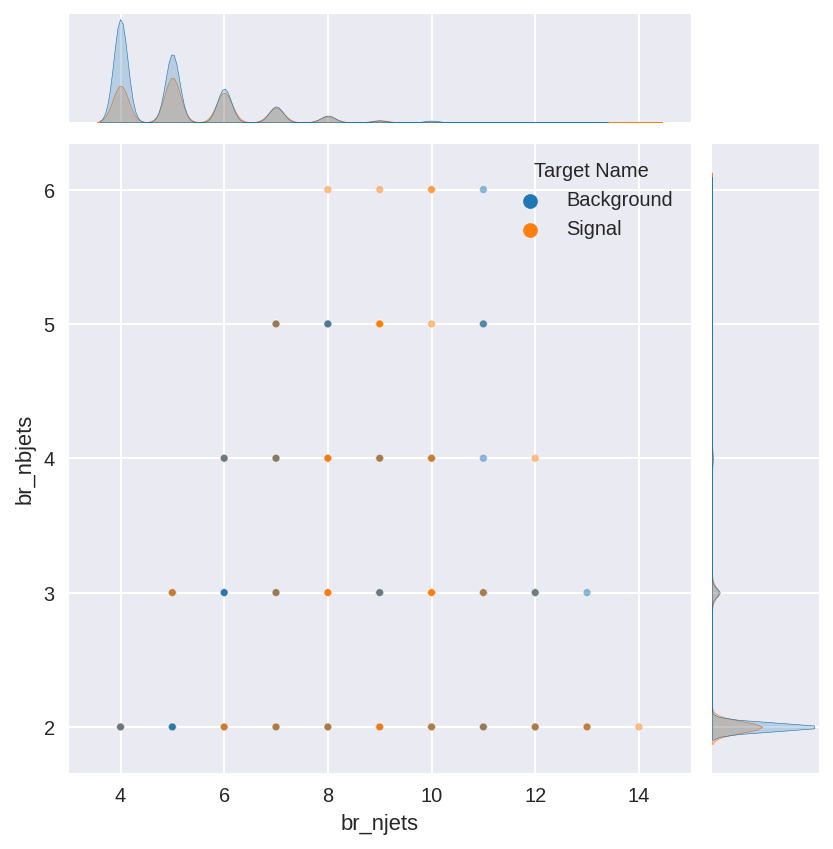

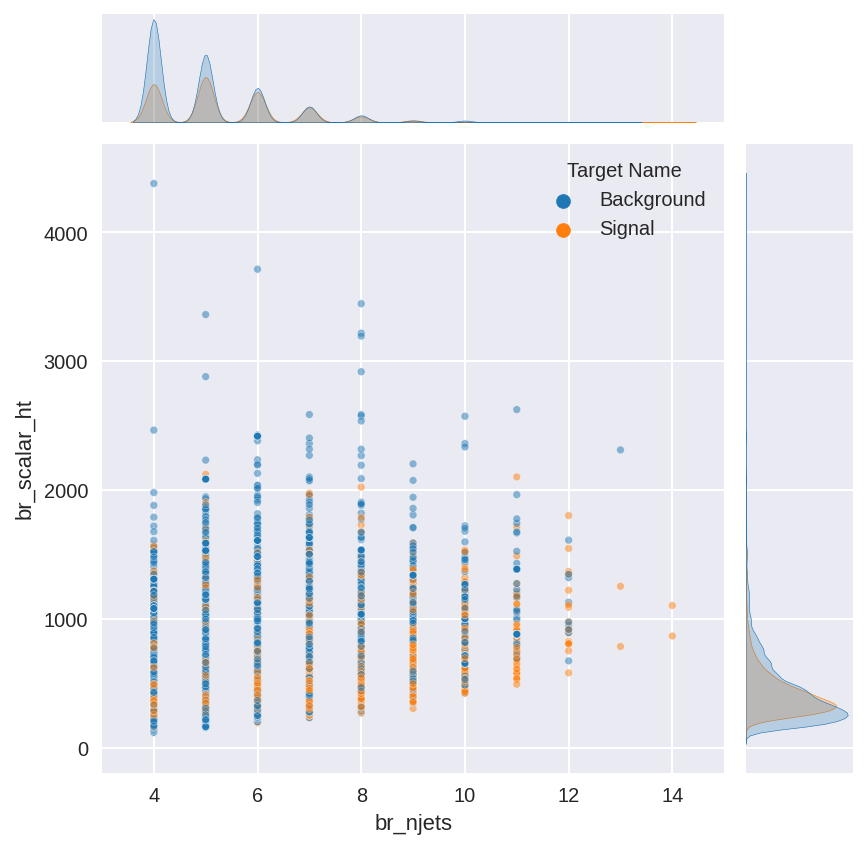

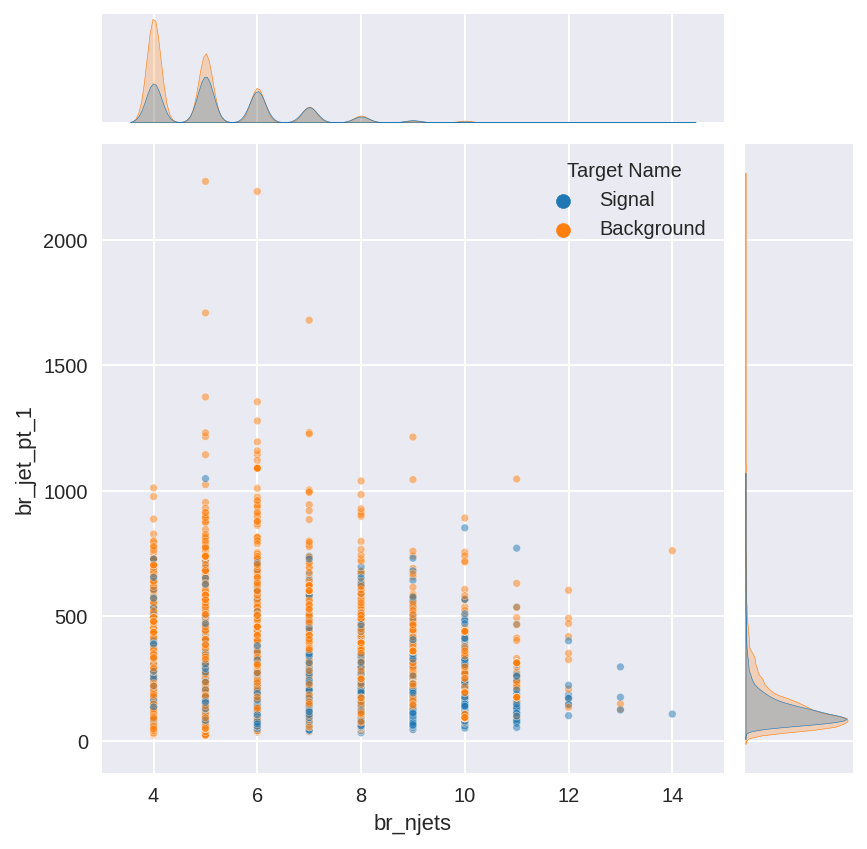

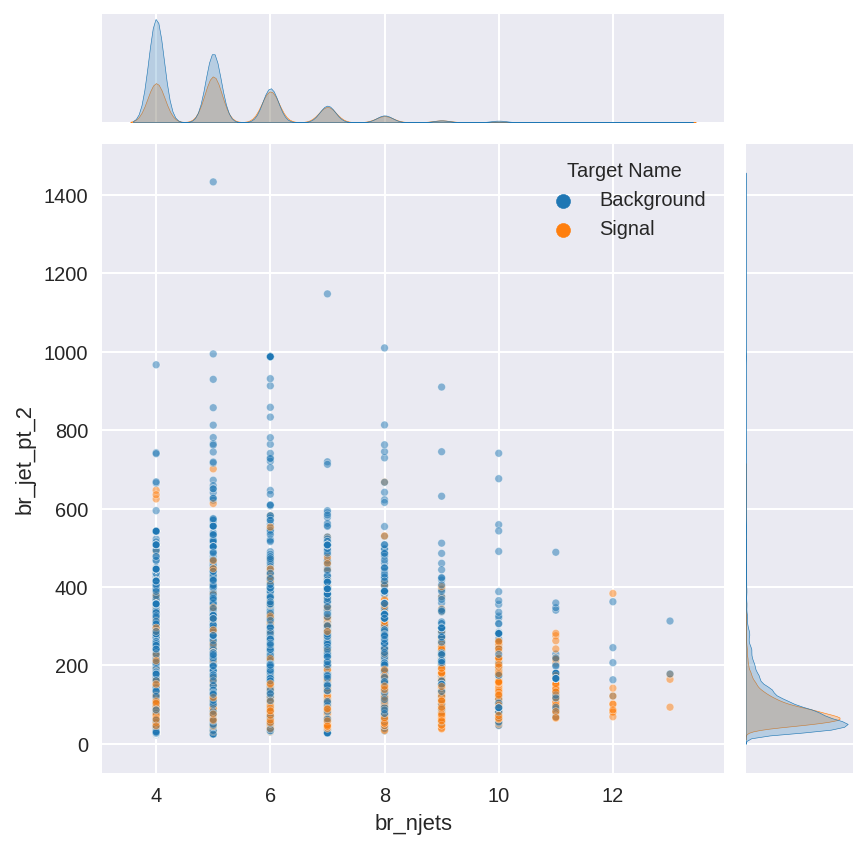

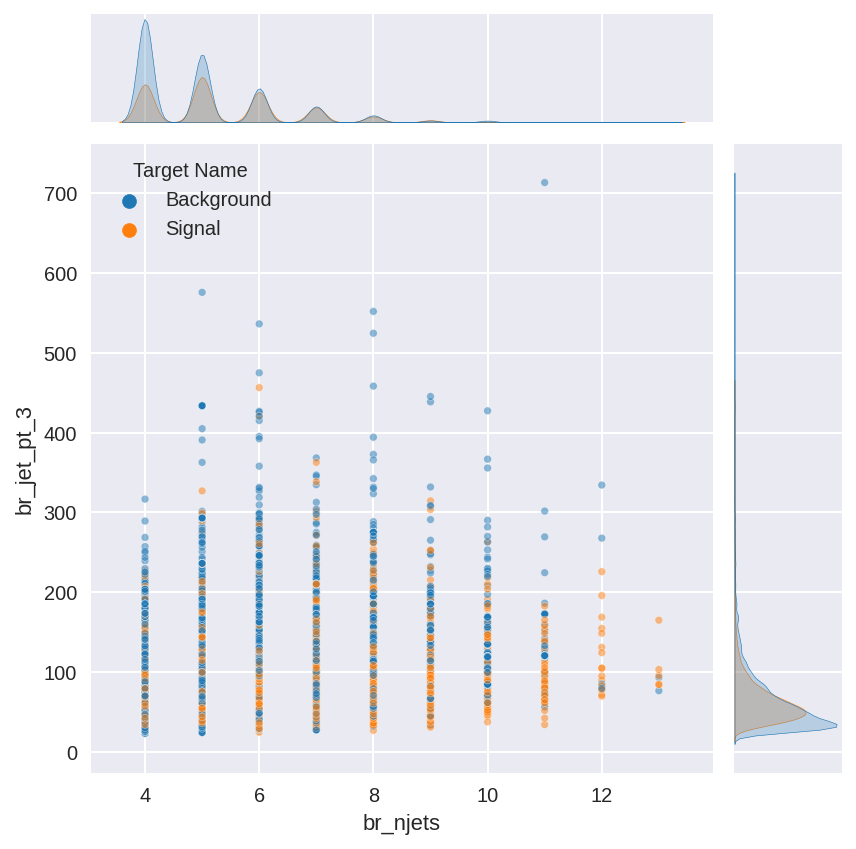

...

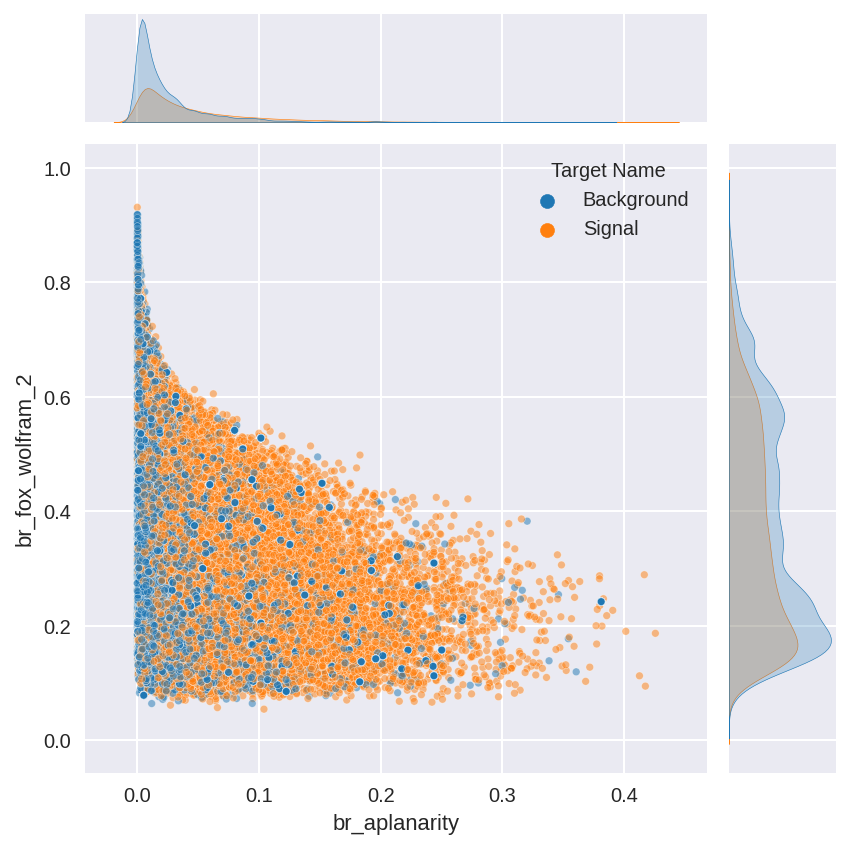

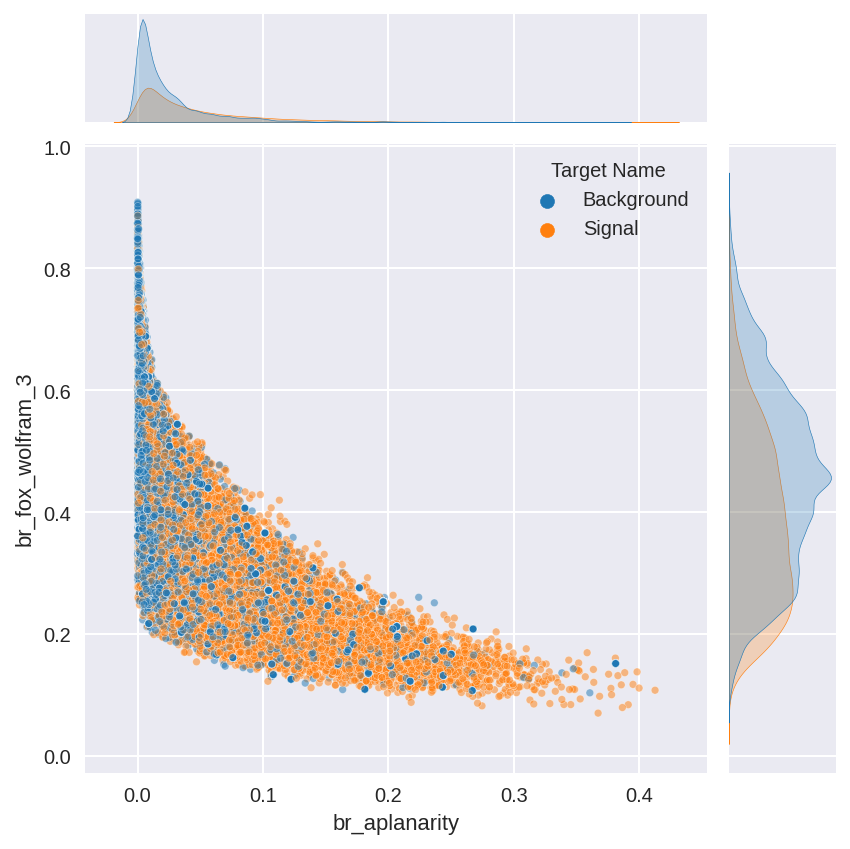

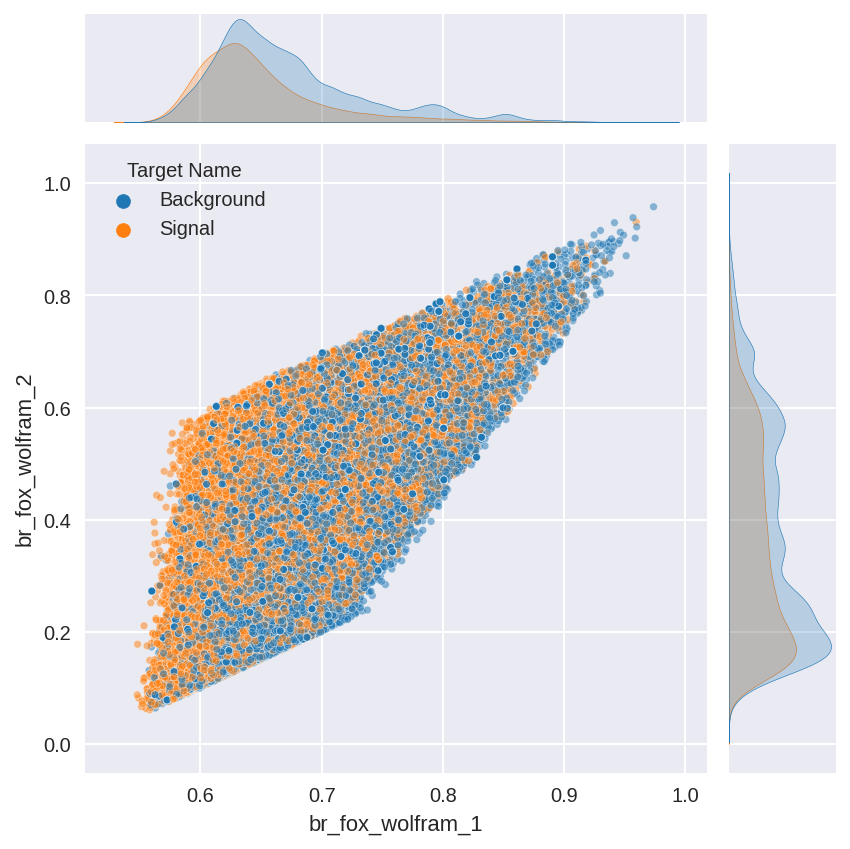

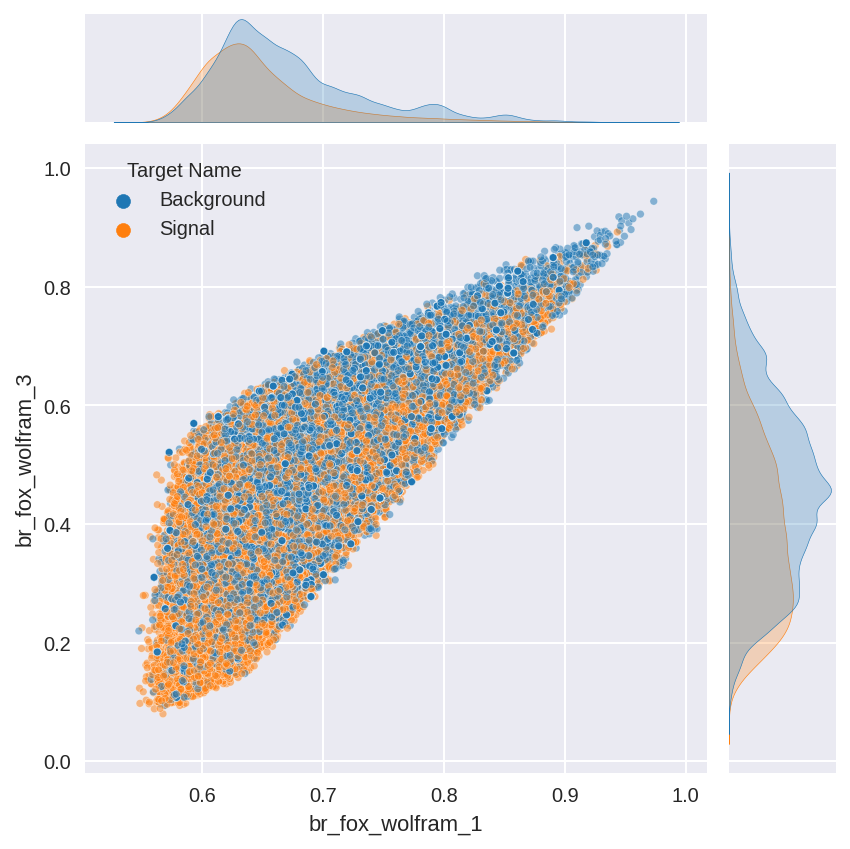

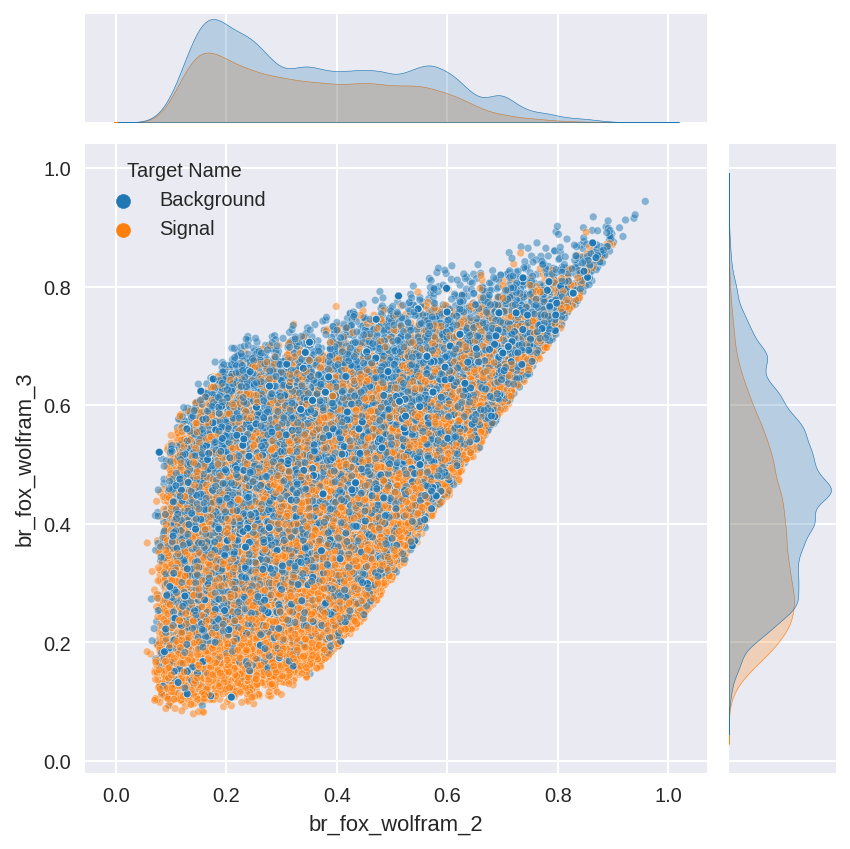

In [11]:
plt.style.use("seaborn")
for variables in comb_features:
    sns.jointplot(data=df[[variables[0], variables[1], "Target Name"]].iloc[np.random.choice(range(len(df)), 100000, replace=False)], 
                  x=variables[0], y=variables[1], hue="Target Name", palette="tab10", s=15, alpha=0.5)
    plt.savefig("feature_plots/"+str(variables[0]) + "_vs_" + str(variables[1]) + ".png", dpi=200)

In [ ]:
x_signal = df[df["target"]==1][['Number of Jets', 'Scalar HT',
       '1st Jet pT ', '2nd Jet pT', '3rd Jet pT', '4th Jet pT', 'MET',
       'MET Phi', 'Sphericity', 'Aplanarity', 'Fox-Wolfram 1',
       'Fox-Wolfram 2', 'Fox-Wolfram 3', 'Fox-Wolfram 4']]

x_bkg = df[df["target"]==0][['Number of Jets', 'Scalar HT',
       '1st Jet pT ', '2nd Jet pT', '3rd Jet pT', '4th Jet pT', 'MET',
       'MET Phi', 'Sphericity', 'Aplanarity', 'Fox-Wolfram 1',
       'Fox-Wolfram 2', 'Fox-Wolfram 3', 'Fox-Wolfram 4']]

In [ ]:
x_sig_train, x_sig_test, y_sig_train, y_sig_test = train_test_split(x_signal, y_signal, test_size=0.5, random_state=20)
x_bkg_train, x_bkg_test, y_bkg_train, y_bkg_test = train_test_split(x_bkg, y_bkg, test_size=0.5, random_state=20)

x_train = np.concatenate((x_sig_train, x_bkg_train), axis=0)
y_train = np.concatenate((y_sig_train, y_bkg_train), axis=0)

x_test = np.concatenate((x_sig_test, x_bkg_test), axis=0)
y_test = np.concatenate((y_sig_test, y_bkg_test), axis=0)
                                  
scaler  = preprocessing.StandardScaler().fit(np.concatenate((x_train, x_test), axis=0))
dump(scaler, open('scaler.pkl', 'wb'))
x_train = scaler.transform(x_train)
x_test  = scaler.transform(x_test)

In [ ]:
x_train[0]

In [ ]:
print("training for", len(x_train), "events;", "testing for",  len(x_test), "events")

In [ ]:
import keras
import tensorflow as tf
config = tf.ConfigProto( device_count = {'GPU': 2 , 'CPU': 36} ) 
sess = tf.Session(config=config) 
keras.backend.set_session(sess)

In [ ]:
from datetime import datetime
from packaging import version

tf.keras.callbacks.TensorBoard(
    log_dir='logs', histogram_freq=0, write_graph=True,
    write_images=False, update_freq='epoch', profile_batch=2,
    embeddings_freq=0, embeddings_metadata=None)

In [ ]:
def simple_model():
    
    model = Sequential()
    model.add(Dense(1024, activation='relu'))
    model.add(Dense(1024, activation='sigmoid'))
    model.add(Dense(1,  activation='sigmoid', name="output_layer"))
    
    model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.00146), metrics=['accuracy'])
    
    return model

In [ ]:
epoch_size = 300
batch_size = 2**10

dnn_model  = simple_model()
history = dnn_model.fit(x_train, y_train, epochs=300, batch_size=2**9,  verbose=1, 
                    validation_data=(x_test, y_test), 
                    callbacks = [ReduceLROnPlateau(monitor='val_accuracy', factor=0.95, 
                                    patience=5, verbose=1, min_delta=1e-4, mode='auto', min_lr=1.0e-5)])

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
# plot loss during training
plt.subplot(211)
plt.title('Loss')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.ylim(0,1)
# plot accuracy during training
plt.subplot(212)
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()
plt.subplots_adjust(hspace=0.5)
plt.ylim(0,1)
plt.show()

In [ ]:
x_signal_trans = scaler.transform(x_signal)

In [ ]:
dnn_model.predict(np.array( [x_signal_trans[6],] ))

In [ ]:
output_array1 = dnn_model.predict_proba(scaler.transform(x_sig_train))
output_array2 = dnn_model.predict_proba(scaler.transform(x_bkg_train))

output_array3 = dnn_model.predict_proba(scaler.transform(x_sig_test))
output_array4 = dnn_model.predict_proba(scaler.transform(x_bkg_test))

In [ ]:
plt.style.use("seaborn")
fig, ax = plt.subplots()
n_bins = 20

y, bins, patches = ax.hist(output_array2, bins=n_bins, density=True, color='blue', alpha=0.5, label='background(training)')
y, bins, patches = ax.hist(output_array4, bins=n_bins, density=True, color='blue', alpha=0.0)
bin_centers = [0.5*(bins[i]+bins[i+1]) for i in range(len(bins)-1)]
plt.scatter(bin_centers, y, marker='o', c='blue', s=40, alpha=1,  label='background(test)')

y, bins, patches = ax.hist(output_array1, bins=n_bins, density=True, color='red', alpha=0.5, label='signal(training)')
y, bins, patches = ax.hist(output_array3, bins=n_bins, density=True, color='red', alpha=0.0)
bin_centers = [0.5*(bins[i]+bins[i+1]) for i in range(len(bins)-1)]
plt.scatter(0.5*(bins[1:] + bins[:-1]), y, marker='o', c='red', s=40, alpha=1, label='signal(test)')

ax.set_xlabel('model output')
ax.set_ylabel('Probability density')
ax.set_title("")
ax.legend()
#ax.set_yscale('log')

In [ ]:
def get_signal_significance(xsec_sig, xsec_bkg, lumi, output_sig, output_bkg, thresholds):
    
    significance = []
    
    for threshold in thresholds:
        
        n_sig_expected = xsec_sig * lumi
        n_bkg_expected = xsec_bkg * lumi
        
        n_sig_pred_correct = len(output_sig[output_sig>threshold])
        n_sig_pred_wrong   = len(output_sig[output_sig<threshold])
        n_bkg_pred_correct = len(output_bkg[output_bkg<threshold])
        n_bkg_pred_wrong   = len(output_bkg[output_bkg>threshold])
        
        eff_sig = n_sig_pred_correct/len(output_sig)
        eff_bkg = n_bkg_pred_correct/len(output_bkg)
        
        n_sig = n_sig_expected * eff_sig
        n_bkg = n_bkg_expected * (1-eff_bkg)
        
        n_observed = n_sig + n_bkg
        
        if n_bkg > 0:
            sig = math.sqrt(2*n_observed*math.log(1+n_sig/n_bkg)-2*n_sig)
            #sig = n_sig/math.sqrt(n_sig+n_bkg)
        else:
            sig = 0
        
        print("threshold:", "{:.3f}".format(threshold), "\n"
              "eff_sig:", "{:.3f}".format(eff_sig),
              "eff_bkg:", "{:.3f}".format(eff_bkg),
              "n_sig:", "{:.0f}".format(n_sig), 
              "n_bkg:", "{:.0f}".format(n_bkg),
              "n_observed:", "{:.0f}".format(n_observed), "\n",
              "significance:", "{:.3f}".format(sig), "\n\n")
        
        significance.append(sig)    
        
    return thresholds, np.array(significance)

In [ ]:
thresholds , significance = get_signal_significance(1, 1, 50000, output_array1, 
                                                    output_array2, np.arange(0.1, 1-1e-3, 1e-2))

In [ ]:
max_sig_threshold = thresholds[np.where(significance==max(significance))][0]
print(max(significance))
plt.figure(1)
plt.plot([max_sig_threshold, max_sig_threshold], [0, 1.05*max(significance)], 'k--')
plt.plot(thresholds, significance, label='maximum signal significance \n@ threshold = {:.3f}'.format(max_sig_threshold), color="red")
plt.xlabel('threshold')
plt.ylabel(r"$S/\sqrt{S+B}$")
plt.ylim([0.5*max(significance),1.1*max(significance)])
plt.title('signal significance')
plt.legend(loc="best")
plt.savefig("significance.pdf")

In [ ]:
from sklearn.metrics import roc_curve
y_pred_keras = dnn_model.predict(x_test).ravel()
fpr_keras, tpr_keras, thresholds_keras = roc_curve(y_test, y_pred_keras)

from sklearn.metrics import auc
auc_keras = auc(fpr_keras, tpr_keras)

In [ ]:
plt.figure(1)
plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr_keras,tpr_keras, label='(AUC = {:.3f})'.format(auc_keras))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')
plt.legend(loc='best')
plt.show()